In [1]:
import networkx as nx
import gurobipy as gp
import matplotlib.pyplot as plt
from gurobipy import GRB

In [2]:
import osmnx as ox

%matplotlib inline
ox.__version__

'1.3.0'

## Download Genova network map

In [3]:
totG = ox.graph_from_place('Genova, Liguria, Italy', network_type="drive")
ox.save_graphml(totG, filepath="wholegenova.graphml", gephi=True,encoding="utf-8")

## Read graph from Neo4j

After import wholegenova.graphml in Neo4j and do a preprosessing data, export the graph and read the new wholegenovaExport.graphml

In [2]:
G = nx.read_graphml("wholegenovaExport.graphml")

/Users/laudie/opt/anaconda3/envs/socialMining/lib/python3.9/site-packages/networkx/readwrite/graphml.py:1031: UserWarning: No key type for id coordinates. Using string
  warnings.warn(f"No key type for id {attr_id}. Using string")
/Users/laudie/opt/anaconda3/envs/socialMining/lib/python3.9/site-packages/networkx/readwrite/graphml.py:1031: UserWarning: No key type for id labels. Using string
  warnings.warn(f"No key type for id {attr_id}. Using string")
/Users/laudie/opt/anaconda3/envs/socialMining/lib/python3.9/site-packages/networkx/readwrite/graphml.py:1031: UserWarning: No key type for id junction. Using string
  warnings.warn(f"No key type for id {attr_id}. Using string")
/Users/laudie/opt/anaconda3/envs/socialMining/lib/python3.9/site-packages/networkx/readwrite/graphml.py:1031: UserWarning: No key type for id area. Using string
  warnings.warn(f"No key type for id {attr_id}. Using string")
/Users/laudie/opt/anaconda3/envs/socialMining/lib/python3.9/site-packages/networkx/readwrit

In [5]:
for u, v, attr in G.edges(data=True):
    attr['length'] = float(attr['length'])  # Conversione del peso in un valore numerico

In [4]:
shortest_paths = nx.all_pairs_dijkstra_path_length(G, weight='length')

In [5]:
shortest_paths = dict(shortest_paths)  

In [6]:
import pickle
#with open('shortest_paths_reachability_graph.pickle', 'wb') as f:
#    pickle.dump(shortest_paths, f)

with open('shortest_paths_reachability_graph.pickle', 'rb') as f:
    shortest_paths = pickle.load(f)

In [7]:
shortest_paths['n0']['n16']

979.624

In [11]:
# Inizializza il grafo RG vuoto
reach_graph = nx.DiGraph()

# Itera su tutte le coppie di nodi e verifica la distanza
for node1 in G.nodes():
    for node2 in G.nodes():
        if node1 != node2:
            try:
                if shortest_paths[node1][node2]:
                    distance = shortest_paths[node1][node2]  # Ottieni la distanza tra i nodi
                    if distance <= 3000:
                        reach_graph.add_edge(node1, node2, weight=distance)  # Aggiungi l'arco con l'attributo di distanza
            except:
                continue



In [12]:
reach_graph.number_of_edges()

6110142

In [13]:
nx.write_graphml_lxml(reach_graph, "reach_graph_all_pairs.graphml")

Database Neo4j nome ReachabilityWholeGenova

dump del database: reachability-whole-genova-neo4j-Jun-14-2023-15-15-09.dump

## Leggo grafo di raggiungibilità

In [2]:
reach_graph = nx.read_graphml("reach_graph_all_pairs.graphml")

In [9]:
reach_graph.get_edge_data('n0', 'n15')

{'weight': 1077.888}

In [3]:
for u, v, attr in reach_graph.edges(data=True):
    attr['weight'] = float(attr['weight'])  # Conversione del peso in un valore numerico

## Minimum Dominating set 

In [6]:
def solve_dominating_set(graph):
    model = gp.Model("dominating-set")

    # Creazione delle variabili di decisione
    dominating_set = model.addVars(graph.nodes, vtype=GRB.BINARY, name="dominating_set")

    # Obiettivo: minimizzare la cardinalità del dominating set
    model.setObjective(dominating_set.sum(), GRB.MINIMIZE)

    # Vincolo: ogni nodo deve essere nel dominating set o avere almeno un vicino nel dominating set
    for node in graph.nodes:
        successors = graph.successors(node)
        model.addConstr(dominating_set[node] + gp.quicksum(dominating_set[neighbor] for neighbor in successors) >= 1)

    # Vincolo: il numero di nodi nel dominating set deve essere almeno k
    #model.addConstr(dominating_set.sum() >= k)

    # Risoluzione del modello
    model.optimize()

    if model.status == GRB.OPTIMAL:
        # Estrazione del dominating set ottimo
        dominating_set_solution = [node for node in graph.nodes if dominating_set[node].x > 0.5]
        return dominating_set_solution
    else:
        return None


In [7]:
solve_dominating_set(reach_graph)

Set parameter Username
Academic license - for non-commercial use only - expires 2024-06-21
Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[arm])

CPU model: Apple M1 Pro
Thread count: 10 physical cores, 10 logical processors, using up to 10 threads

Optimize a model with 8977 rows, 8977 columns and 6119119 nonzeros
Model fingerprint: 0x190b5b93
Variable types: 0 continuous, 8977 integer (8977 binary)
Coefficient statistics:
  Matrix range     [1e+00, 1e+00]
  Objective range  [1e+00, 1e+00]
  Bounds range     [1e+00, 1e+00]
  RHS range        [1e+00, 1e+00]
Found heuristic solution: objective 117.0000000
Presolve removed 8977 rows and 8977 columns
Presolve time: 0.69s
Presolve: All rows and columns removed

Explored 0 nodes (0 simplex iterations) in 0.87 seconds (1.36 work units)
Thread count was 1 (of 10 available processors)

Solution count 2: 92 117 

Optimal solution found (tolerance 1.00e-04)
Best objective 9.200000000000e+01, best bound 9.200000000000e+01, gap 0.0000%


['n299',
 'n408',
 'n834',
 'n1090',
 'n2188',
 'n3743',
 'n8731',
 'n3583',
 'n4457',
 'n7770',
 'n8622',
 'n71',
 'n3155',
 'n6987',
 'n4140',
 'n701',
 'n1517',
 'n798',
 'n4237',
 'n444',
 'n4271',
 'n3305',
 'n926',
 'n532',
 'n1177',
 'n4510',
 'n319',
 'n582',
 'n323',
 'n5513',
 'n925',
 'n1145',
 'n4290',
 'n4487',
 'n340',
 'n5210',
 'n709',
 'n714',
 'n2697',
 'n5842',
 'n613',
 'n5253',
 'n6954',
 'n5734',
 'n5851',
 'n6911',
 'n8447',
 'n635',
 'n876',
 'n4439',
 'n7179',
 'n5473',
 'n913',
 'n4638',
 'n5549',
 'n5879',
 'n5977',
 'n3071',
 'n7513',
 'n1160',
 'n6661',
 'n6674',
 'n1095',
 'n5520',
 'n4866',
 'n6284',
 'n6311',
 'n6538',
 'n4758',
 'n3291',
 'n7072',
 'n6344',
 'n4929',
 'n8128',
 'n3564',
 'n5751',
 'n5821',
 'n5755',
 'n4489',
 'n4694',
 'n4910',
 'n5563',
 'n5338',
 'n5649',
 'n5586',
 'n5542',
 'n5540',
 'n5778',
 'n6790',
 'n5617',
 'n5661',
 'n5942']

In [ ]:
In Neo4j eseguire la seguente query per recuperare i nodi in cui installare le stazioni

WITH ['n299','n408','n834','n1090','n2188','n3743','n8731','n3583','n4457','n7770','n8622','n71','n3155','n6987',
      'n4140','n701','n1517','n798','n4237','n444','n4271','n3305','n926','n532','n1177','n4510','n319','n582',
      'n323','n5513','n925','n1145','n4290','n4487','n340','n5210','n709','n714','n2697','n5842','n613','n5253',
      'n6954','n5734','n5851','n6911','n8447','n635','n876','n4439','n7179','n5473','n913','n4638','n5549','n5879',
      'n5977','n3071','n7513','n1160','n6661','n6674','n1095','n5520','n4866','n6284','n6311','n6538','n4758','n3291',
      'n7072','n6344','n4929','n8128','n3564','n5751','n5821','n5755','n4489','n4694','n4910','n5563','n5338','n5649',
      'n5586','n5542','n5540','n5778','n6790','n5617','n5661','n5942'] as nodes 
UNWIND nodes AS singleNode
WITH apoc.text.replace(singleNode,'n','') as id 
MATCH (p:Point) 
WHERE id(p)=toFloat(id) 
SET p:Station
    

## Risultato: 92 stazioni da aprire


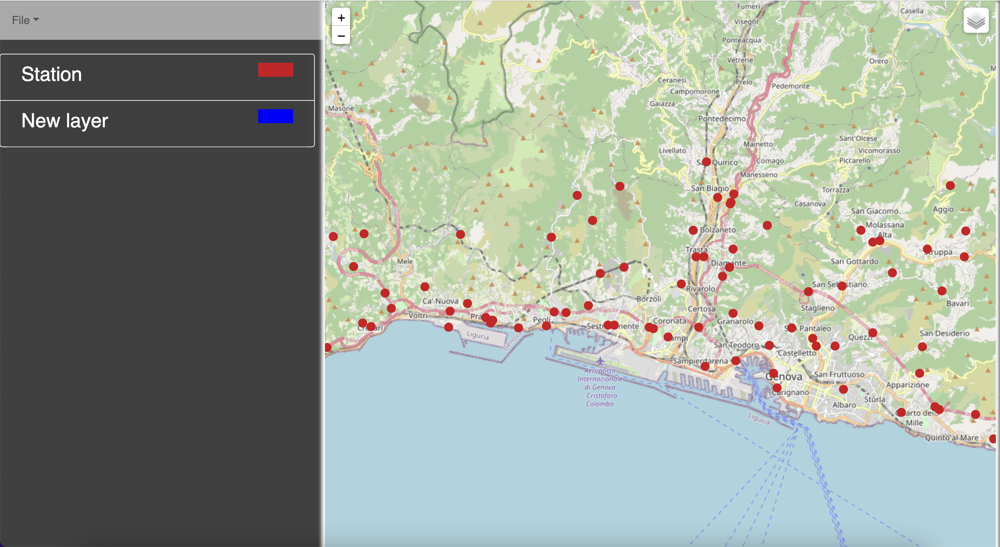

For k-dominating set with k > 1 must to be created a dictionary which for each node Point save their neighbors

In [11]:
subsets = dict()

subsets = {i : list(reach_graph.neighbors(i)) + [i] for i in reach_graph.nodes()}


## k-dominating set with k=2

Risolvo modello dell'insieme dominante con k=2. In questo caso ogni nodo non nell'insieme dominante ha 2 vicini nell'insieme dominante. 
Questi nodi rappresentano eventuali siti candidati in quanto sono stazioni di servizio (carburante) o aree di parcheggio

In [8]:
model = gp.Model("2DominatingSet")

In [9]:
nodes = list(reach_graph.nodes)
x = model.addVars(nodes, vtype=GRB.BINARY, name="x")

In [10]:
# Objective function: minimize the number of nodes in the dominating set
model.setObjective(gp.quicksum(x[i] for i in nodes), GRB.MINIMIZE)

In [12]:
# Constraint: each node not in the dominating set must have at least 2 neighbors in the dominating set
for i in list(subsets.keys()):
    neighbors = subsets[i]
    model.addConstr(gp.quicksum(x[j] for j in neighbors) >= 2 * (1 - x[i]))

In [13]:
model.update()

In [14]:
model.write('2dominatingSet.lp')

In [15]:
model.optimize()

Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[arm])

CPU model: Apple M1 Pro
Thread count: 10 physical cores, 10 logical processors, using up to 10 threads

Optimize a model with 8977 rows, 8977 columns and 6119119 nonzeros
Model fingerprint: 0xa8819830
Variable types: 0 continuous, 8977 integer (8977 binary)
Coefficient statistics:
  Matrix range     [1e+00, 3e+00]
  Objective range  [1e+00, 1e+00]
  Bounds range     [1e+00, 1e+00]
  RHS range        [2e+00, 2e+00]
Found heuristic solution: objective 202.0000000
Presolve removed 4997 rows and 4608 columns
Presolve time: 2.94s
Presolved: 3980 rows, 4369 columns, 1666847 nonzeros
Found heuristic solution: objective 198.0000000
Variable types: 0 continuous, 4369 integer (4191 binary)

Root relaxation: objective 1.516828e+02, 890 iterations, 0.06 seconds (0.10 work units)

    Nodes    |    Current Node    |     Objective Bounds      |     Work
 Expl Unexpl |  Obj  Depth IntInf | Incumbent    BestBd   Gap | It/Node Time

     0 

In [16]:
if model.status == GRB.OPTIMAL:
    print("Optimal solution found.")
    dominating_set = [i for i in nodes if x[i].x > 0.5]
    print("Dominating set:", dominating_set)
else:
    print("No feasible solution found.")

Optimal solution found.
Dominating set: ['n295', 'n299', 'n834', 'n3743', 'n8255', 'n8731', 'n8824', 'n3611', 'n317', 'n4457', 'n7770', 'n8622', 'n7769', 'n4428', 'n6082', 'n7678', 'n2070', 'n3919', 'n6987', 'n918', 'n4144', 'n701', 'n1517', 'n638', 'n4237', 'n3926', 'n444', 'n478', 'n2560', 'n8420', 'n3346', 'n532', 'n1426', 'n6780', 'n7977', 'n4510', 'n2309', 'n6493', 'n319', 'n4492', 'n4831', 'n582', 'n322', 'n323', 'n5513', 'n925', 'n5930', 'n6394', 'n341', 'n8315', 'n5230', 'n3297', 'n709', 'n714', 'n2697', 'n2811', 'n5392', 'n613', 'n1491', 'n5253', 'n5254', 'n6954', 'n8676', 'n5734', 'n5851', 'n6911', 'n6944', 'n8447', 'n8449', 'n635', 'n8049', 'n876', 'n4439', 'n5733', 'n8160', 'n8161', 'n913', 'n4638', 'n5333', 'n5477', 'n5549', 'n5862', 'n5879', 'n5880', 'n1445', 'n8351', 'n5538', 'n5946', 'n5948', 'n8482', 'n6210', 'n2566', 'n1520', 'n3071', 'n7512', 'n7513', 'n3347', 'n1160', 'n7825', 'n6661', 'n6674', 'n6977', 'n1094', 'n1095', 'n5518', 'n5520', 'n4695', 'n6331', 'n7603', 

160 charging station suggests to open


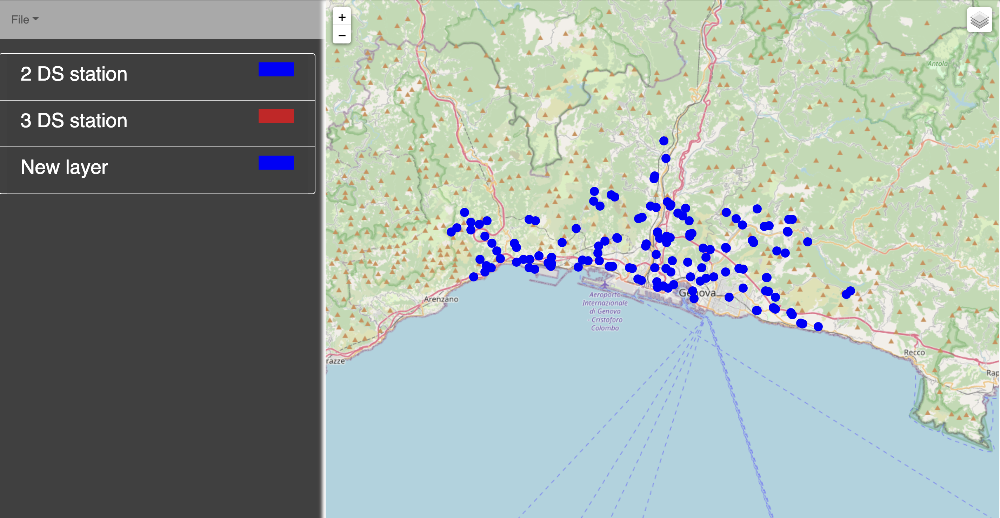

## k-dominating set with k=3

In [17]:
model = gp.Model("3DominatingSet")

In [18]:
nodes = list(reach_graph.nodes)
x = model.addVars(nodes, vtype=GRB.BINARY, name="x")

In [19]:
# Objective function: minimize the number of nodes in the dominating set
model.setObjective(gp.quicksum(x[i] for i in nodes), GRB.MINIMIZE)

In [20]:
# Constraint: each node not in the dominating set must have at least 3 neighbors in the dominating set
for i in list(subsets.keys()):
    neighbors = subsets[i]
    model.addConstr(gp.quicksum(x[j] for j in neighbors) >= 3 * (1 - x[i]))

In [21]:
model.update()

In [22]:
model.write('3dominatingSet.lp')

In [23]:
model.optimize()

Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[arm])

CPU model: Apple M1 Pro
Thread count: 10 physical cores, 10 logical processors, using up to 10 threads

Optimize a model with 8977 rows, 8977 columns and 6119119 nonzeros
Model fingerprint: 0x708cc991
Variable types: 0 continuous, 8977 integer (8977 binary)
Coefficient statistics:
  Matrix range     [1e+00, 4e+00]
  Objective range  [1e+00, 1e+00]
  Bounds range     [1e+00, 1e+00]
  RHS range        [3e+00, 3e+00]
Found heuristic solution: objective 293.0000000
Presolve removed 3388 rows and 1734 columns
Presolve time: 3.48s
Presolved: 5589 rows, 7243 columns, 3166466 nonzeros
Found heuristic solution: objective 287.0000000
Variable types: 0 continuous, 7243 integer (7018 binary)

Root relaxation: objective 2.065119e+02, 1390 iterations, 0.17 seconds (0.32 work units)

    Nodes    |    Current Node    |     Objective Bounds      |     Work
 Expl Unexpl |  Obj  Depth IntInf | Incumbent    BestBd   Gap | It/Node Time

     0

In [24]:
if model.status == GRB.OPTIMAL:
    print("Optimal solution found.")
    dominating_set = [i for i in nodes if x[i].x > 0.5]
    print("Dominating set:", dominating_set)
else:
    print("No feasible solution found.")

Optimal solution found.
Dominating set: ['n60', 'n103', 'n299', 'n452', 'n834', 'n835', 'n1085', 'n1837', 'n2086', 'n3743', 'n3789', 'n8731', 'n1834', 'n317', 'n2597', 'n4457', 'n7770', 'n8622', 'n7769', 'n4263', 'n4428', 'n6082', 'n7678', 'n6987', 'n917', 'n2483', 'n1753', 'n701', 'n1517', 'n798', 'n4237', 'n4240', 'n444', 'n478', 'n492', 'n3277', 'n929', 'n8499', 'n530', 'n7977', 'n2397', 'n2623', 'n4510', 'n6493', 'n320', 'n582', 'n5193', 'n1272', 'n322', 'n323', 'n5513', 'n925', 'n4290', 'n5930', 'n6396', 'n341', 'n2155', 'n3136', 'n5737', 'n3529', 'n5230', 'n709', 'n714', 'n2697', 'n2711', 'n7226', 'n7655', 'n611', 'n613', 'n1362', 'n5253', 'n5254', 'n6954', 'n5703', 'n5734', 'n6911', 'n6945', 'n6947', 'n8444', 'n8445', 'n635', 'n3728', 'n5073', 'n7930', 'n876', 'n1492', 'n4439', 'n5733', 'n7178', 'n8160', 'n8161', 'n5322', 'n913', 'n4638', 'n4922', 'n5549', 'n5879', 'n5880', 'n5605', 'n5612', 'n1445', 'n6211', 'n3158', 'n1520', 'n3071', 'n811', 'n7512', 'n7513', 'n7514', 'n8419',

221 charging station suggest to be open

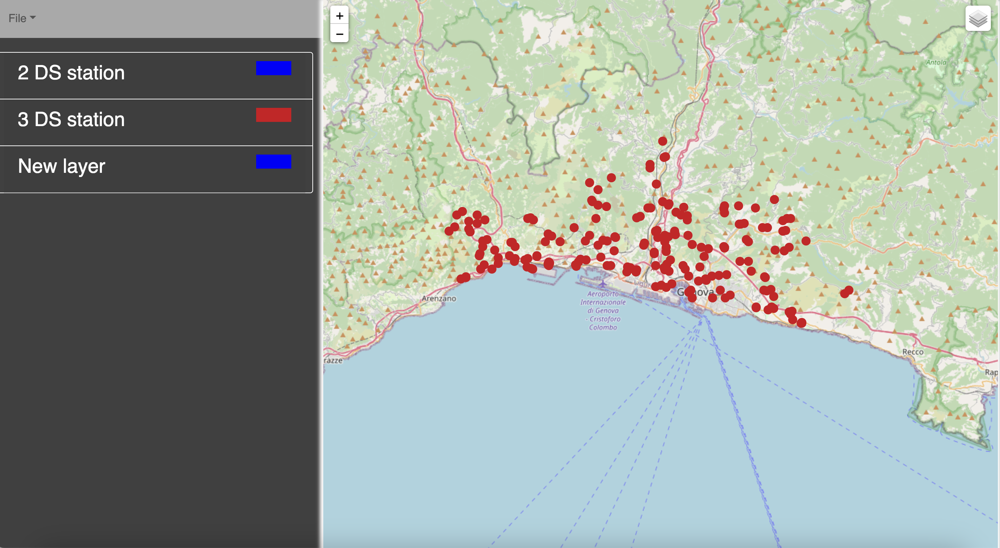

# Results compared

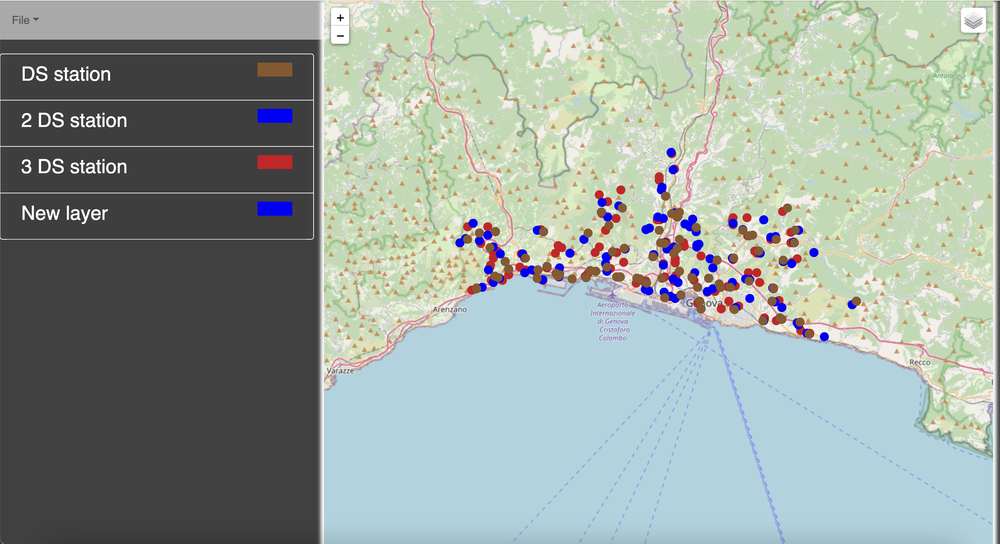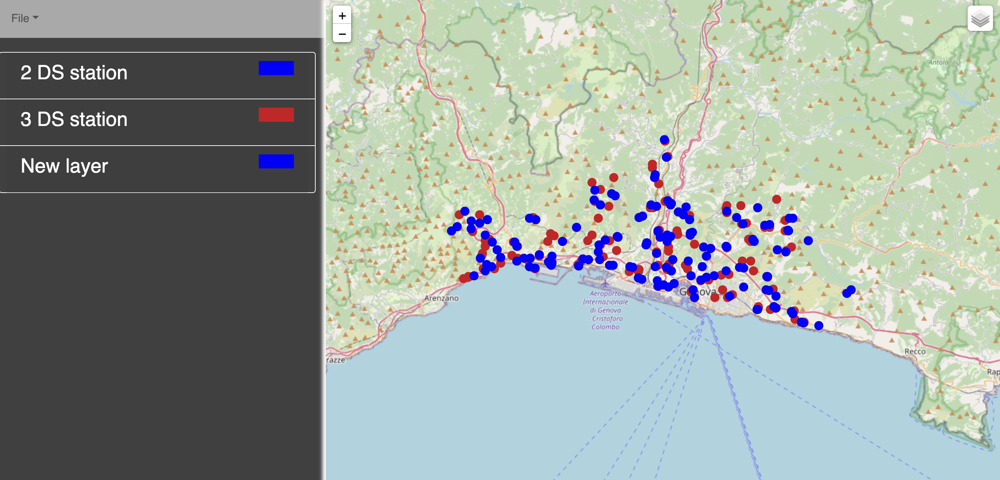

## k-dominating set with k=4

In [32]:
model = gp.Model("4DominatingSet")

In [33]:
nodes = list(reach_graph.nodes)
x = model.addVars(nodes, vtype=GRB.BINARY, name="x")

In [34]:
# Objective function: minimize the number of nodes in the dominating set
model.setObjective(gp.quicksum(x[i] for i in nodes), GRB.MINIMIZE)

In [35]:
# Constraint: each node not in the dominating set must have at least 3 neighbors in the dominating set
for i in list(subsets.keys()):
    neighbors = subsets[i]
    model.addConstr(gp.quicksum(x[j] for j in neighbors) >= 4 * (1 - x[i]))

In [36]:
model.update()

In [37]:
model.write('4dominatingSet.lp')

In [38]:
model.optimize()

Gurobi Optimizer version 10.0.1 build v10.0.1rc0 (mac64[arm])

CPU model: Apple M1 Pro
Thread count: 10 physical cores, 10 logical processors, using up to 10 threads

Optimize a model with 8977 rows, 8977 columns and 6119119 nonzeros
Model fingerprint: 0x5df62364
Variable types: 0 continuous, 8977 integer (8977 binary)
Coefficient statistics:
  Matrix range     [1e+00, 5e+00]
  Objective range  [1e+00, 1e+00]
  Bounds range     [1e+00, 1e+00]
  RHS range        [4e+00, 4e+00]
Found heuristic solution: objective 368.0000000
Presolve removed 3009 rows and 1332 columns (presolve time = 5s) ...
Presolve removed 3024 rows and 1347 columns
Presolve time: 5.38s
Presolved: 5953 rows, 7630 columns, 3765803 nonzeros
Found heuristic solution: objective 367.0000000
Variable types: 0 continuous, 7630 integer (7402 binary)

Root simplex log...

Iteration    Objective       Primal Inf.    Dual Inf.      Time
       0    6.7000000e+01   5.371250e+03   0.000000e+00      6s
    1185    2.5725071e+02   0

     0     0  271.61754    0  460  277.00000  271.61754  1.94%     -   37s
     0     0  271.61987    0  461  277.00000  271.61987  1.94%     -   37s
     0     0  271.62111    0  472  277.00000  271.62111  1.94%     -   38s
     0     0  271.62111    0  407  277.00000  271.62111  1.94%     -   38s

Interrupt request received
     0     2  271.62111    0  401  277.00000  271.62111  1.94%     -   41s
    45    56  273.20418    6  376  277.00000  272.13486  1.76%  42.4   45s
   594   528     cutoff   15       277.00000  272.15237  1.75%  24.0   50s
  1234   946  275.71092   19  338  277.00000  272.16535  1.75%  22.3   55s
  1633  1179  275.16427   21  407  277.00000  272.39659  1.66%  21.8   76s
  1636  1181  275.39970   29  294  277.00000  272.39659  1.66%  21.7   81s
  1650  1190  274.69599   18  364  277.00000  272.39659  1.66%  21.5   85s
  1654  1193  272.77284   10  242  277.00000  272.50298  1.62%  21.5   90s
  1668  1202  274.27201   15  289  277.00000  272.85849  1.50%  21.3   9

In [39]:
if model.status == GRB.OPTIMAL:
    print("Optimal solution found.")
    dominating_set = [i for i in nodes if x[i].x > 0.5]
    print("Dominating set:", dominating_set)
else:
    print("No feasible solution found.")

Optimal solution found.
Dominating set: ['n56', 'n60', 'n295', 'n299', 'n352', 'n781', 'n834', 'n1836', 'n1837', 'n3743', 'n5239', 'n6888', 'n8731', 'n1834', 'n317', 'n430', 'n2597', 'n3026', 'n4457', 'n4720', 'n7770', 'n8622', 'n7769', 'n71', 'n376', 'n4263', 'n4428', 'n6082', 'n7678', 'n1824', 'n6987', 'n917', 'n2483', 'n1901', 'n3318', 'n701', 'n1517', 'n799', 'n4240', 'n4320', 'n6703', 'n444', 'n478', 'n492', 'n6055', 'n926', 'n929', 'n530', 'n532', 'n1426', 'n7977', 'n2397', 'n4510', 'n3556', 'n3557', 'n319', 'n320', 'n1262', 'n4492', 'n582', 'n5192', 'n1271', 'n1272', 'n322', 'n323', 'n812', 'n5513', 'n925', 'n1743', 'n5925', 'n5930', 'n6396', 'n341', 'n2155', 'n8315', 'n3271', 'n3274', 'n5230', 'n709', 'n714', 'n2697', 'n2712', 'n5001', 'n7155', 'n7227', 'n612', 'n613', 'n1362', 'n1491', 'n5253', 'n5254', 'n5868', 'n6954', 'n5703', 'n5734', 'n6911', 'n6944', 'n6945', 'n6947', 'n8447', 'n635', 'n636', 'n3728', 'n5073', 'n7930', 'n876', 'n1492', 'n4439', 'n5733', 'n7178', 'n7179',

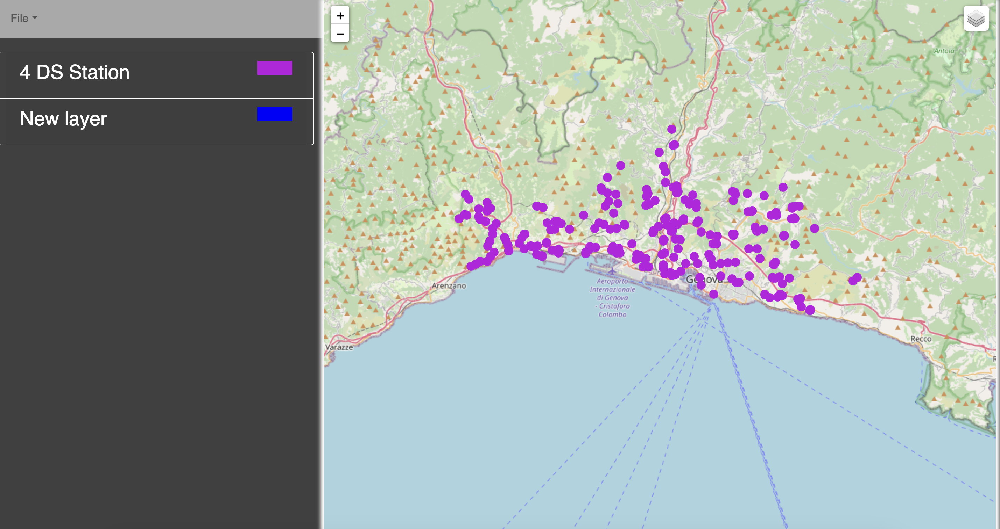